<h3>Boxiao Qiang 1163451</h3>
<h3>Math3790 w1</h3>
<h3>Assignment 7</h3>

In [1]:
import nltk
from collections import Counter
import pandas as pd

# 定义语料库路径
corpus_root = "C:\\Users\\27615\\Desktop\\温肯课程\\这是2024.2开始的\\数学机器学习3790 1班\\我的assignments\\作业8\\english-corpora"
corpus = nltk.corpus.PlaintextCorpusReader(corpus_root, "movies_text.txt")
corpus_text = corpus.raw()

# 标记
tokens = nltk.word_tokenize(corpus_text)

# 提取'good'和'old'后面的单词
words_after_good = [tokens[i+1] for i in range(len(tokens)-1) if tokens[i].lower() == 'good']
words_after_old = [tokens[i+1] for i in range(len(tokens)-1) if tokens[i].lower() == 'old']

# 统计单词出现次数
words_after_good_count = Counter(words_after_good)
words_after_old_count = Counter(words_after_old)

# 将Counter对象转换为DataFrame并排序
words_after_good_df = pd.DataFrame(words_after_good_count.items(), columns=['w', 'C(good, w)']).sort_values(by='C(good, w)', ascending=False)
words_after_old_df = pd.DataFrame(words_after_old_count.items(), columns=['w', 'C(old, w)']).sort_values(by='C(old, w)', ascending=False)

# 合并DataFrame并显示
combined_df = pd.concat([words_after_good_df.reset_index(drop=True), words_after_old_df.reset_index(drop=True)], axis=1)
print("Words occurring after 'good' and 'old' are:")
display(combined_df)


Words occurring after 'good' and 'old' are:


,w,"C(good, w)",w,"C(old, w)"
0,.,1014,man,146.0
1,night,282,.,92.0
2,",",208,",",44.0
3,morning,160,friend,32.0
4,to,138,lady,22.0
...,...,...,...,...
563,bear,1,NaN,NaN
564,housekeeper,1,NaN,NaN
565,swimmer,1,NaN,NaN
566,payer,1,NaN,NaN


### Justeson and Katz (JKF)' method 

In [3]:
import nltk
from collections import Counter
import pandas as pd

# Define the corpus root directory
corpus_root = "C:\\Users\\27615\\Desktop\\温肯课程\\这是2024.2开始的\\数学机器学习3790 1班\\我的assignments\\作业8\\english-corpora"

# Load the plaintext corpus
corpus = nltk.corpus.PlaintextCorpusReader(corpus_root, "movies_text.txt")
corpus_text = corpus.raw()

# Tokenize the corpus text
tokens = nltk.word_tokenize(corpus_text)

# Perform part-of-speech tagging
tagged_tokens = nltk.pos_tag(tokens)

# Define a function to extract nouns following 'good' and 'old' patterns
def extract_nouns_after_adjective(tagged_tokens, token_A, pos_tag, pos_tag_following):
    nouns = [tagged_tokens[i+1][0] for i in range(len(tagged_tokens)-1) if (tagged_tokens[i][0].lower() == token_A) and tagged_tokens[i][1].startswith(pos_tag) and tagged_tokens[i+1][1].startswith(pos_tag_following)]
    return nouns

# Extract nouns following 'good' and 'old' patterns
nns_after_good = extract_nouns_after_adjective(tagged_tokens, 'good', 'JJ', 'NN')
nns_after_old = extract_nouns_after_adjective(tagged_tokens, 'old', 'JJ', 'NN')

# Count occurrences of each noun
nns_after_good_count = Counter(nns_after_good)
nns_after_old_count = Counter(nns_after_old)

# Convert Counter objects to DataFrame
nns_after_good_df = pd.DataFrame(nns_after_good_count.items(), columns=['w', 'C(good, w)'])
nns_after_old_df = pd.DataFrame(nns_after_old_count.items(), columns=['w', 'C(old, w)'])

# Sort DataFrames by count in descending order
nns_after_good_df = nns_after_good_df.sort_values(by='C(good, w)', ascending=False)
nns_after_old_df = nns_after_old_df.sort_values(by='C(old, w)', ascending=False)

# Combine DataFrames horizontally
# combined_df = pd.concat([nns_after_good_df, nns_after_old_df], axis=1)
combined_df = pd.concat([nns_after_good_df.reset_index(drop=True), nns_after_old_df.reset_index(drop=True)], axis=1)

# Display top few rows of each DataFrame without row labels
print("Nouns occurring after 'good' and 'old' are:")
display(combined_df)


Nouns occurring after 'good' and 'old' are:


,w,"C(good, w)",w,"C(old, w)"
0,night,266,man,143.0
1,morning,150,friend,31.0
2,luck,114,lady,22.0
3,evening,72,times,17.0
4,idea,69,girl,16.0
...,...,...,...,...
436,turn,1,NaN,NaN
437,swim,1,NaN,NaN
438,lovin,1,NaN,NaN
439,butane,1,NaN,NaN


### Mean-Variance method

In [6]:
import nltk

# 读取语料库
corpus_root = "C:\\Users\\27615\\Desktop\\温肯课程\\这是2024.2开始的\\数学机器学习3790 1班\\我的assignments\\作业8\\english-corpora"
corpus = nltk.corpus.PlaintextCorpusReader(corpus_root, "movies_text.txt")
corpus_text = corpus.raw()

# 载入分词器
tokenizer = nltk.tokenize.RegexpTokenizer(r"(?<!\.{1})\.(?!\.)|[^\d\s@]+")

# 对文本进行分词
tokens = tokenizer.tokenize(corpus_text)

# 定义共现窗口的大小  collocational window = 8
window_size = 20

# 用共现窗口的方法划分文本
sens_list = []

for i in range(len(tokens)):   
    # 获取窗口内的词语
    context_words = tokens[i: i+window_size]
    sens_list.append(context_words)

display(sens_list)


[['Either',
  'you',
  "'re",
  'flat',
  'or',
  'I',
  'am',
  '.',
  'I',
  'beg',
  'your',
  'pardon',
  '.',
  'Excuse',
  'me',
  '.',
  'Always',
  'the',
  'lady',
  '.'],
 ['you',
  "'re",
  'flat',
  'or',
  'I',
  'am',
  '.',
  'I',
  'beg',
  'your',
  'pardon',
  '.',
  'Excuse',
  'me',
  '.',
  'Always',
  'the',
  'lady',
  '.',
  'Say'],
 ["'re",
  'flat',
  'or',
  'I',
  'am',
  '.',
  'I',
  'beg',
  'your',
  'pardon',
  '.',
  'Excuse',
  'me',
  '.',
  'Always',
  'the',
  'lady',
  '.',
  'Say',
  '...'],
 ['flat',
  'or',
  'I',
  'am',
  '.',
  'I',
  'beg',
  'your',
  'pardon',
  '.',
  'Excuse',
  'me',
  '.',
  'Always',
  'the',
  'lady',
  '.',
  'Say',
  '...',
  'Say'],
 ['or',
  'I',
  'am',
  '.',
  'I',
  'beg',
  'your',
  'pardon',
  '.',
  'Excuse',
  'me',
  '.',
  'Always',
  'the',
  'lady',
  '.',
  'Say',
  '...',
  'Say',
  ','],
 ['I',
  'am',
  '.',
  'I',
  'beg',
  'your',
  'pardon',
  '.',
  'Excuse',
  'me',
  '.',
  'Always',
  't

In [7]:
# 定义要查找的token
token_A = 'good'
token_B = 'god'

# 存储A和B 这2个token之间的distances
dists_between_A_B = []
 

# 遍历每个句子
for sen in sens_list:
    # 初始化索引列表
    indices_A = []
    indices_B = []
    
    # 遍历每个单词和它的索引
    for index, word in enumerate(sen):
        # 如果单词是 "A"，将它的索引添加到 me_indices 列表中
        if word == token_A:
            indices_A.append(index)
        # 如果单词是 "B"，将它的索引添加到 all_indices 列表中
        elif word == token_B:
            indices_B.append(index)
    
    # 如果同时出现了 "me" 和 "all"，计算它们的索引差
    if indices_A and indices_B:
        for index_A in indices_A:
            for index_B in indices_B:
                dist_A_B = index_A - index_B
                dists_between_A_B.append(dist_A_B)
display(dists_between_A_B)

[-13,
 -13,
 -13,
 -13,
 -13,
 -13,
 -13,
 11,
 11,
 11,
 11,
 11,
 11,
 11,
 11,
 11,
 -12,
 -12,
 -12,
 -12,
 -12,
 -12,
 -12,
 -12,
 -19,
 -14,
 -14,
 -14,
 -14,
 -14,
 -14,
 13,
 13,
 13,
 13,
 13,
 13,
 13,
 17,
 17,
 17]

In [8]:
# calculate the mean of the distances between these two tokens
sum_of_dists = sum(dists_between_A_B)

mean_dist = sum_of_dists / len(dists_between_A_B)
print(mean_dist)

-1.1951219512195121


In [9]:
# calculate the variance of the distances
squared_dist_diffs = 0

for dist in dists_between_A_B:
    squared_dist_diff = (dist - mean_dist)**2
    squared_dist_diffs += squared_dist_diff

variance_dist = squared_dist_diffs / len(dists_between_A_B)
print(variance_dist)


169.57168352171317


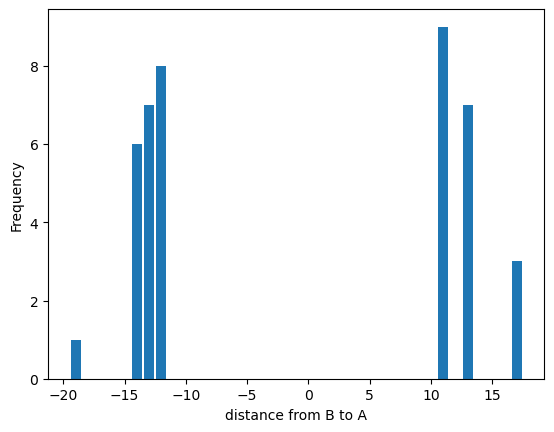

In [10]:
import matplotlib.pyplot as plt
from collections import Counter

# 统计元素的频率
frequency_counter = Counter(dists_between_A_B)

# 获取元素和对应的频率
dists = list(frequency_counter.keys())
frequencies = list(frequency_counter.values())

# 绘制直方图
plt.bar(dists, frequencies)
plt.xlabel('distance from B to A')
plt.ylabel('Frequency')
#plt.title('Frequency of Elements in dists_between_A_B')
plt.show()


### T test & chi-square test

In [11]:
import numpy as np
from scipy import stats
import nltk

# Define the corpus root directory
corpus_root = "C:\\Users\\27615\\Desktop\\温肯课程\\这是2024.2开始的\\数学机器学习3790 1班\\我的assignments\\作业8\\english-corpora"

# Load the plaintext corpus
corpus = nltk.corpus.PlaintextCorpusReader(corpus_root, "movies_text.txt")
corpus_text = corpus.raw()

# Tokenize the corpus
tokenized_corpus = nltk.word_tokenize(corpus_text)

# 将语料库分成bigrams
bigrams = list(nltk.bigrams(tokenized_corpus))

# 计算包含特定token或短语的bigrams的出现次数
def count_token_in_bigrams(token, bigrams):
    return sum(1 for bigram in bigrams if token in bigram)

def count_bigram_in_bigrams(bigram_1_2, bigrams):
    return bigrams.count(tuple(bigram_1_2.split()))

# 定义要比较的两个token
token1 = "good"
token2 = "god"
bigram_1_2 = token1 + " " + token2 # phrase

count_token1 = count_token_in_bigrams(token1, bigrams)
count_token2 = count_token_in_bigrams(token2, bigrams)
count_bigram_1_2 = count_bigram_in_bigrams(bigram_1_2, bigrams)
count_bigrams = len(bigrams)
print(f"Count of token '{token1}' in bigrams: {count_token1}")
print(f"Count of token '{token2}' in bigrams: {count_token2}")
print(f"Count of bigram '{bigram_1_2}' in bigrams: {count_bigram_1_2}")
print(f"Count of bigrams of corpus: {count_bigrams}", end='\n\n')

# 输出频率
freq_token1 = count_token1 / count_bigrams
freq_token2 = count_token2 / count_bigrams
freq_bigram_1_2 = count_bigram_1_2 / count_bigrams
print(f"Frequency of token '{token1}' in corpus:", freq_token1)
print(f"Frequency of token '{token2}' in corpus:", freq_token2)
print(f"Frequency of bigram '{bigram_1_2}' in corpus:", freq_bigram_1_2)
# get H0: p(token1)*p(token2)
freq_bigram_1_2_H0 = freq_token1 * freq_token2
print(f"H0 Frequency of bigram '{bigram_1_2}' in corpus:", freq_bigram_1_2_H0, end='\n\n')

# calculate variance (2 ways)
var1_t_test = (freq_bigram_1_2_H0) * (1 - freq_bigram_1_2_H0)     # formula for Bernoulli trial
print("variance 1 for T-test:", var1_t_test)      

sum_square_diff = 0
for i in range(count_bigrams):
    if bigram_1_2 == bigrams[i]:
        sum_square_diff += (0 - freq_bigram_1_2)**2
    else:
        sum_square_diff += (1/count_bigrams - freq_bigram_1_2)**2
var2_t_test = np.sqrt(sum_square_diff / (count_bigrams-1))        # real sampling variance
print("variance 2 for T-test:", var2_t_test)

# calculate the T value
t_statistic_ofVar1 = (freq_bigram_1_2 - freq_bigram_1_2_H0) / np.sqrt(var1_t_test / count_bigrams)
print("t-value calculated by var1:", t_statistic_ofVar1)
t_statistic_ofVar2 = (freq_bigram_1_2 - freq_bigram_1_2_H0) / np.sqrt(var2_t_test / count_bigrams)
print("t-value calculated by var2:", t_statistic_ofVar2, end='\n\n')

# if t value > 2.576 which is corresponding to critical value 'α'=0.005, we can reject the null hypothesis with 99.5% confidence
if np.abs(t_statistic_ofVar1) > 2.576 and np.abs(t_statistic_ofVar2) > 2.576:
    print(f"'{token1}' and '{token2}' are not independent.")
else:
    print(f"'{token1}' and '{token2}' are independent.")




Count of token 'good' in bigrams: 5614
Count of token 'god' in bigrams: 264
Count of bigram 'good god' in bigrams: 0
Count of bigrams of corpus: 2175647

Frequency of token 'good' in corpus: 0.0025803818358400973
Frequency of token 'god' in corpus: 0.00012134321422546948
Frequency of bigram 'good god' in corpus: 0.0
H0 Frequency of bigram 'good god' in corpus: 3.1311182588985515e-07

variance 1 for T-test: 3.131117278508396e-07
variance 2 for T-test: 4.596334928549528e-07
t-value calculated by var1: -0.8253611439607166
t-value calculated by var2: -0.6812207263795149

'good' and 'god' are independent.


In [12]:
# if first-word=token1, second-word=token2 ...  (dependent)
c_tok1_tok2 = 0
c_Ntok1_Ntok2 = 0
c_tok1_Ntok2 = 0
c_Ntok1_tok2 = 0
for i in range(count_bigrams):
    if bigrams[i][0] == token1 and bigrams[i][1] == token2:
        c_tok1_tok2 += 1
    elif bigrams[i][0] != token1 and bigrams[i][1] != token2:
        c_Ntok1_Ntok2 += 1
    elif bigrams[i][0] == token1 and bigrams[i][1] != token2:
        c_tok1_Ntok2 += 1
    else:
        c_Ntok1_tok2 += 1
grand_total = c_tok1_tok2 + c_Ntok1_Ntok2 + c_tok1_Ntok2 + c_Ntok1_tok2
print("c_tok1_tok2:", c_tok1_tok2)
print("c_Ntok1_Ntok2:", c_Ntok1_Ntok2)
print("c_tok1_Ntok2", c_tok1_Ntok2)
print("c_Ntok1_tok2", c_Ntok1_tok2)
print("Grand total:", grand_total, end='\n\n')
obs_m = np.array([[c_tok1_tok2, c_Ntok1_tok2], [c_tok1_Ntok2, c_Ntok1_Ntok2]])   # observed matrix
print('Observed matrix:')
display(obs_m)

# row m & col n (independent)
c11 = (c_tok1_tok2 + c_Ntok1_tok2) * (c_tok1_tok2 + c_tok1_Ntok2) /grand_total
c12 = (c_tok1_tok2 + c_Ntok1_tok2) * (c_Ntok1_tok2 + c_Ntok1_Ntok2) /grand_total
c21 = (c_tok1_Ntok2 + c_Ntok1_Ntok2) * (c_tok1_tok2 + c_tok1_Ntok2) /grand_total
c22 = (c_tok1_Ntok2 + c_Ntok1_Ntok2) * (c_Ntok1_tok2 + c_Ntok1_Ntok2) /grand_total
print('c11:', c11)
print('c12:', c12)
print('c21:', c21)
print('c22:', c22)
exp_m = np.array([[c11, c12], [c21, c22]])   # expected matrix
print('Expected matrix:')
display(exp_m)

# D_m: deviation matrix
D_m = obs_m - exp_m
print('Deviation matrix:')
display(D_m)

# use Hadamard Product to calculate the norm of deviation matrix
chi_square_m = (D_m * D_m) / exp_m
chi_square = np.sum(chi_square_m)
print("chi-square:", chi_square)

# d.f.= (2-1)(2-1)=1  If chi-square value > 3.84, we could reject the null hypothesis
if chi_square > 3.84:
    print(f"'{token1}' and '{token2}' are not independent.")
else:
    print(f"'{token1}' and '{token2}' are independent.")

c_tok1_tok2: 0
c_Ntok1_Ntok2: 2172708
c_tok1_Ntok2 2807
c_Ntok1_tok2 132
Grand total: 2175647

Observed matrix:


array([[      0,     132],
       [   2807, 2172708]])

c11: 0.17030520116544642
c12: 131.82969479883457
c21: 2806.8296947988347
c22: 2172708.1703052013
Expected matrix:


array([[1.70305201e-01, 1.31829695e+02],
       [2.80682969e+03, 2.17270817e+06]])

Deviation matrix:


array([[-0.1703052,  0.1703052],
       [ 0.1703052, -0.1703052]])

chi-square: 0.17053555791063846
'good' and 'god' are independent.


### Likelihood Ratio Test

In [14]:
# c1, c2, c12, N prepared for calculating likelihood ratio
c_tok1 = 0
c_tok2 = 0
for i in range(count_bigrams):
    if bigrams[i][0] == token1:
        c_tok1 += 1
    if bigrams[i][1] == token2:
        c_tok2 += 1
print("c_tok1:", c_tok1)
print("c_tok2:", c_tok2, end='\n\n')

# p for hypothesis 1 (independent), p1 and p2 for hypothesis 2 (dependent)
p = c_tok2 / count_bigrams
p1 = c_tok1_tok2 / c_tok1
p2 = (c_tok2 - c_tok1_tok2) / (count_bigrams - c_tok1)
print("p:", p)
print("p1:", p1)
print("p2:", p2, end='\n\n')

# define a function to calculate log(L(k, n, x)) = log(x**k * (1-x)**(n-k))
def log_L(k, n, x):
    if x != 0 and (1-x) != 0:
        log_l_val = k * np.log(x) + (n - k) * np.log(1 - x)
    elif x == 0:
        log_l_val = k * np.log(x+10**(-10)) + (n - k) * np.log(1 - x)
    else:
        log_l_val = k * np.log(x+10**(-10)) + (n - k) * np.log(1 - x + 10**(-10))
    print(log_l_val)
    return log_l_val

# calculate the Dunning Statistic -2log(λ) = -2log( L(H1)/L(H2) )
dun_statistic = -2 * (log_L(c_tok1_tok2, c_tok1, p) + log_L(c_tok2 - c_tok1_tok2, count_bigrams - c_tok1, p) - \
                      log_L(c_tok1_tok2, c_tok1, p1) - log_L(c_tok2 - c_tok1_tok2, count_bigrams - c_tok1, p2))
print("Dunning statistic:", dun_statistic)

# d.f.= (1+1)-1= 1 --> p1+p2 - p, use chi-square critical value
if dun_statistic > 3.84:
    print(f"'{token1}' and '{token2}' are not independent.")
else:
    print(f"'{token1}' and '{token2}' are independent.")


c_tok1: 2807
c_tok2: 132

p: 6.067160711273474e-05
p1: 0.0
p2: 6.0749986193184954e-05

-0.17031036771962407
-1413.550269182302
0.0
-1413.550159217923
Dunning statistic: 0.3408406641970032
'good' and 'god' are independent.


### Analyzing POS using HMM

In [16]:
from collections import defaultdict, Counter
import nltk

nltk.download('brown')

tagged_corpus = nltk.corpus.brown.tagged_sents()
display(tagged_corpus)


[nltk_data] Downloading package brown to
[nltk_data]     C:\Users\27615\AppData\Roaming\nltk_data...
[nltk_data]   Package brown is already up-to-date!


[[('The', 'AT'), ('Fulton', 'NP-TL'), ('County', 'NN-TL'), ('Grand', 'JJ-TL'), ('Jury', 'NN-TL'), ('said', 'VBD'), ('Friday', 'NR'), ('an', 'AT'), ('investigation', 'NN'), ('of', 'IN'), ("Atlanta's", 'NP$'), ('recent', 'JJ'), ('primary', 'NN'), ('election', 'NN'), ('produced', 'VBD'), ('``', '``'), ('no', 'AT'), ('evidence', 'NN'), ("''", "''"), ('that', 'CS'), ('any', 'DTI'), ('irregularities', 'NNS'), ('took', 'VBD'), ('place', 'NN'), ('.', '.')], [('The', 'AT'), ('jury', 'NN'), ('further', 'RBR'), ('said', 'VBD'), ('in', 'IN'), ('term-end', 'NN'), ('presentments', 'NNS'), ('that', 'CS'), ('the', 'AT'), ('City', 'NN-TL'), ('Executive', 'JJ-TL'), ('Committee', 'NN-TL'), (',', ','), ('which', 'WDT'), ('had', 'HVD'), ('over-all', 'JJ'), ('charge', 'NN'), ('of', 'IN'), ('the', 'AT'), ('election', 'NN'), (',', ','), ('``', '``'), ('deserves', 'VBZ'), ('the', 'AT'), ('praise', 'NN'), ('and', 'CC'), ('thanks', 'NNS'), ('of', 'IN'), ('the', 'AT'), ('City', 'NN-TL'), ('of', 'IN-TL'), ('Atlant

In [17]:
import string

def filter_pos_tagging(tagged_sentences):
    filtered_sentences = []
    for sentence in tagged_sentences:
        if sentence:  # Check if sentence is not empty
            filtered_sentence = []
            for word, pos in sentence:
                if not all(char in string.punctuation for char in word):
                    filtered_sentence.append((word, pos))
            if filtered_sentence:  # Check if filtered_sentence is not empty, empty list is 'false'
                filtered_sentences.append(filtered_sentence)
    return filtered_sentences

filtered_sentences = filter_pos_tagging(tagged_corpus)
print("filtered corpus:")
display(filtered_sentences)

total_sentences = len(filtered_sentences)


# initial prob, transition prob, emission prob, tag set,
start_prob = {}
transition_counts = defaultdict(Counter)
emission_counts = defaultdict(Counter)
tags = set()

for sentence in filtered_sentences:
    for i in range(len(sentence) - 1):

        word, current_tag = sentence[i]
        next_tag = sentence[i + 1][1]


        emission_counts[current_tag][word] += 1
        transition_counts[current_tag][next_tag] += 1
        tags.add(current_tag)
        tags.add(next_tag)

# initial tag prob
initial_tag_counts = Counter([sentence[0][1] for sentence in filtered_sentences])
print("initial tag counts:", len(initial_tag_counts))

for tag in tags:
    if tag in initial_tag_counts:
        start_prob[tag] = initial_tag_counts[tag] / total_sentences
    else:
        start_prob[tag] = 1e-10    # not exist in this corpus, assign a very little prob

print("initial probabilities:")
display(start_prob)
print("Number of items in start_prob:", len(start_prob))

# 计算状态转移概率和发射概率
trans_prob = {current_tag: {next_tag: count / sum(next_tags.values()) for next_tag, count in next_tags.items()} for current_tag, next_tags in transition_counts.items()}
# 将tags转换为列表
tag_list = list(tags)
# 先检查trans_prob中是否有缺失的key，若有，则添加缺失的key并设置初始值为1e-10
for tag in tag_list:
    if tag not in trans_prob:
        trans_prob[tag] = {single_tag: 1e-10 for single_tag in tag_list}
for single_tag in trans_prob:
    for tag in tag_list:
        # if tag not in trans_prob[tag] (值) -> 
        if tag not in trans_prob[single_tag]:
            trans_prob[single_tag][tag] = 1e-10


emit_prob = {tag: {word: count / sum(words.values()) for word, count in words.items()} for tag, words in emission_counts.items()}
# 检查是否有缺失的tag，若有，则添加缺失的tag并设置 所有word的初始值为1e-10
word_list = [single_sentence[i][0] for single_sentence in filtered_sentences for i in range(len(single_sentence)-1)]
for tag in tag_list:
    if tag not in emit_prob:
        emit_prob[tag] = {}
        for single_word in word_list:
            # if single_sentence[i][0] not in emit_prob[tag]:
            emit_prob[tag][single_word] = 1e-10

for single_tag in emit_prob:
    for word in word_list:
        if word not in emit_prob[single_tag]:
            emit_prob[single_tag][word] = 1e-10

print("transition probability:")
display(trans_prob)
print("emission probability:")
display(emit_prob)
print("Tags:")
display(tags)

filtered corpus:


[[('The', 'AT'),
  ('Fulton', 'NP-TL'),
  ('County', 'NN-TL'),
  ('Grand', 'JJ-TL'),
  ('Jury', 'NN-TL'),
  ('said', 'VBD'),
  ('Friday', 'NR'),
  ('an', 'AT'),
  ('investigation', 'NN'),
  ('of', 'IN'),
  ("Atlanta's", 'NP$'),
  ('recent', 'JJ'),
  ('primary', 'NN'),
  ('election', 'NN'),
  ('produced', 'VBD'),
  ('no', 'AT'),
  ('evidence', 'NN'),
  ('that', 'CS'),
  ('any', 'DTI'),
  ('irregularities', 'NNS'),
  ('took', 'VBD'),
  ('place', 'NN')],
 [('The', 'AT'),
  ('jury', 'NN'),
  ('further', 'RBR'),
  ('said', 'VBD'),
  ('in', 'IN'),
  ('term-end', 'NN'),
  ('presentments', 'NNS'),
  ('that', 'CS'),
  ('the', 'AT'),
  ('City', 'NN-TL'),
  ('Executive', 'JJ-TL'),
  ('Committee', 'NN-TL'),
  ('which', 'WDT'),
  ('had', 'HVD'),
  ('over-all', 'JJ'),
  ('charge', 'NN'),
  ('of', 'IN'),
  ('the', 'AT'),
  ('election', 'NN'),
  ('deserves', 'VBZ'),
  ('the', 'AT'),
  ('praise', 'NN'),
  ('and', 'CC'),
  ('thanks', 'NNS'),
  ('of', 'IN'),
  ('the', 'AT'),
  ('City', 'NN-TL'),
  ('of',

initial tag counts: 225
initial probabilities:


{'FW-VBG-TL': 1e-10,
 'PN-NC': 1e-10,
 'NR-HL': 6.998023058485978e-05,
 'RP-NC': 1e-10,
 'EX': 0.014538392904004618,
 'WRB+BER': 1.7495057646214944e-05,
 'JJR-NC': 1e-10,
 'RB$': 1e-10,
 'PN$': 5.248517293864483e-05,
 'FW-UH-NC': 1e-10,
 'PPSS-TL': 1e-10,
 'FW-NR': 1e-10,
 'FW-NN-NC': 1e-10,
 'BEN': 1e-10,
 'VBN+TO': 1e-10,
 'JJ-TL-NC': 1e-10,
 'NR-NC': 1e-10,
 'NN$-TL': 6.998023058485978e-05,
 'FW-WPS': 1.7495057646214944e-05,
 'WDT-HL': 0.0003848912682167288,
 'DO-NC': 1e-10,
 'NN+BEZ-TL': 1.7495057646214944e-05,
 'FW-AT+NP-TL': 1e-10,
 'VBZ-TL': 1e-10,
 'UH-TL': 1e-10,
 'DOZ*-TL': 1e-10,
 'VBD-HL': 5.248517293864483e-05,
 'BED-NC': 1e-10,
 'FW-BE': 1e-10,
 'NP+BEZ-NC': 1.7495057646214944e-05,
 'FW-NNS-TL': 3.499011529242989e-05,
 'VBN-HL': 0.0004898616140940184,
 'DTS': 0.007470389614933781,
 'WDT+BEZ-HL': 1.7495057646214944e-05,
 'DOD-NC': 1e-10,
 'PN-HL': 1.7495057646214944e-05,
 'AP+AP-NC': 1e-10,
 'VBG': 0.010951906086530554,
 'AT-TL-HL': 3.499011529242989e-05,
 'VB+RP': 3.49901

Number of items in start_prob: 452
transition probability:


{'AT': {'NP-TL': 0.008423524606902185,
  'NN': 0.4965795384929549,
  'NN-TL': 0.02647539309781499,
  'NP': 0.022911986930773943,
  'JJ': 0.20107208494996937,
  'JJT': 0.006932816009801919,
  'AP': 0.030784153563406167,
  'NNS': 0.07392280988360221,
  'NN$': 0.00927098223402083,
  'VBG': 0.01611190524811109,
  'CD': 0.010057177863998366,
  'JJS': 0.0021033285685113333,
  'VBN': 0.015090871962425974,
  'JJ-TL': 0.014733510312436185,
  'NPS': 0.006003675719828467,
  'OD': 0.012813967735348172,
  'NNS$': 0.0010006126199714111,
  'RB': 0.00360424749846845,
  'QL': 0.01414131100673882,
  'JJS-TL': 2.0420665713702267e-05,
  'NN$-TL': 0.0016642842556667348,
  'JJR': 0.0064427200326730655,
  'VBN-TL': 0.003992240147028793,
  'NR-TL': 0.002123749234225036,
  'NNS-TL': 0.0029507861956299774,
  'FW-IN': 7.147232999795794e-05,
  'ABN': 0.00042883397998774763,
  'NR': 0.002236062895650398,
  'NPS$': 0.000306309985705534,
  'PN': 0.001521339595670819,
  'NNS$-TL': 0.00029609965284868285,
  '*': 5.105

emission probability:


{'AT': {'The': 0.06864406779661017,
  'an': 0.03591995099040229,
  'no': 0.016081274249540534,
  'the': 0.6358791096589749,
  'a': 0.22276904227077804,
  'A': 0.011425362466816419,
  'every': 0.004431284459873392,
  'An': 0.001919542577088013,
  'Every': 0.0005717786399836635,
  'No': 0.0023381662242189095,
  "th'": 1.0210332856851133e-05,
  "ever'": 1.0210332856851133e-05,
  'Fulton': 1e-10,
  'County': 1e-10,
  'Grand': 1e-10,
  'Jury': 1e-10,
  'said': 1e-10,
  'Friday': 1e-10,
  'investigation': 1e-10,
  'of': 1e-10,
  "Atlanta's": 1e-10,
  'recent': 1e-10,
  'primary': 1e-10,
  'election': 1e-10,
  'produced': 1e-10,
  'evidence': 1e-10,
  'that': 1e-10,
  'any': 1e-10,
  'irregularities': 1e-10,
  'took': 1e-10,
  'jury': 1e-10,
  'further': 1e-10,
  'in': 1e-10,
  'term-end': 1e-10,
  'presentments': 1e-10,
  'City': 1e-10,
  'Executive': 1e-10,
  'Committee': 1e-10,
  'which': 1e-10,
  'had': 1e-10,
  'over-all': 1e-10,
  'charge': 1e-10,
  'deserves': 1e-10,
  'praise': 1e-10,

Tags:


{'*',
 '*-HL',
 '*-NC',
 '*-TL',
 'ABL',
 'ABN',
 'ABN-HL',
 'ABN-NC',
 'ABN-TL',
 'ABX',
 'AP',
 'AP$',
 'AP+AP-NC',
 'AP-HL',
 'AP-NC',
 'AP-TL',
 'AT',
 'AT-HL',
 'AT-NC',
 'AT-TL',
 'AT-TL-HL',
 'BE',
 'BE-HL',
 'BE-TL',
 'BED',
 'BED*',
 'BED-NC',
 'BEDZ',
 'BEDZ*',
 'BEDZ-HL',
 'BEDZ-NC',
 'BEG',
 'BEM',
 'BEM*',
 'BEM-NC',
 'BEN',
 'BEN-TL',
 'BER',
 'BER*',
 'BER*-NC',
 'BER-HL',
 'BER-NC',
 'BER-TL',
 'BEZ',
 'BEZ*',
 'BEZ-HL',
 'BEZ-NC',
 'BEZ-TL',
 'CC',
 'CC-HL',
 'CC-NC',
 'CC-TL',
 'CC-TL-HL',
 'CD',
 'CD$',
 'CD-HL',
 'CD-NC',
 'CD-TL',
 'CD-TL-HL',
 'CS',
 'CS-HL',
 'CS-NC',
 'CS-TL',
 'DO',
 'DO*',
 'DO*-HL',
 'DO+PPSS',
 'DO-HL',
 'DO-NC',
 'DO-TL',
 'DOD',
 'DOD*',
 'DOD*-TL',
 'DOD-NC',
 'DOZ',
 'DOZ*',
 'DOZ*-TL',
 'DOZ-HL',
 'DOZ-TL',
 'DT',
 'DT$',
 'DT+BEZ',
 'DT+BEZ-NC',
 'DT+MD',
 'DT-HL',
 'DT-NC',
 'DT-TL',
 'DTI',
 'DTI-HL',
 'DTI-TL',
 'DTS',
 'DTS+BEZ',
 'DTS-HL',
 'DTX',
 'EX',
 'EX+BEZ',
 'EX+HVD',
 'EX+HVZ',
 'EX+MD',
 'EX-HL',
 'EX-NC',
 'FW-*',
 'FW-

In [18]:
display(len(tags))
display(len(word_list))
display(len(start_prob))
display(len(emit_prob))
display(len(trans_prob))

452

956160

452

452

452

In [19]:
display(trans_prob['BED'])
display(len(trans_prob['BED']))

display(emit_prob['RBR'])
display(len(emit_prob['RBR']))

{'AT': 0.05812174977057204,
 '*': 0.0336494340776996,
 'RBR': 0.0015295197308045274,
 'VBN': 0.30926888956867543,
 'RB': 0.11410217191801775,
 'VBG': 0.09788926277148975,
 'IN': 0.052615478739675745,
 'NNS': 0.02906087488528602,
 'CS': 0.004588559192413582,
 'TO': 0.022636892015907004,
 'RP': 0.0061180789232181095,
 'JJ': 0.11440807586417864,
 'EX': 0.0003059039461609055,
 'CD': 0.01896604466197614,
 'NP': 0.011012542061792597,
 'NNS-TL': 0.000611807892321811,
 'AP': 0.014071581523401652,
 'BEG': 0.0061180789232181095,
 'NN': 0.007035790761700826,
 'QL': 0.04099112878556133,
 'VBD': 0.0003059039461609055,
 'ABX': 0.004282655246252677,
 'ABN': 0.00948302233098807,
 'DTS': 0.0027531355154481493,
 'NP$': 0.001223615784643622,
 'PP$': 0.005506271030896299,
 'NN-TL': 0.000611807892321811,
 'CC': 0.004588559192413582,
 'PN': 0.0030590394616090547,
 'JJT': 0.000611807892321811,
 'DTI': 0.004282655246252677,
 'HVG': 0.0015295197308045274,
 'NR': 0.0009177118384827164,
 'ABL': 0.000305903946160

452

{'further': 0.07766990291262135,
 'earlier': 0.04854368932038835,
 'better': 0.1407766990291262,
 'later': 0.2543689320388349,
 'higher': 0.010679611650485437,
 'tougher': 0.000970873786407767,
 'Earlier': 0.002912621359223301,
 'Later': 0.035922330097087375,
 'more': 0.16213592233009708,
 'harder': 0.011650485436893204,
 'longer': 0.10776699029126213,
 'closer': 0.03300970873786408,
 'sooner': 0.013592233009708738,
 'less': 0.018446601941747572,
 'faster': 0.009708737864077669,
 'Further': 0.014563106796116505,
 'More': 0.003883495145631068,
 'easier': 0.003883495145631068,
 'Better': 0.006796116504854369,
 'farther': 0.019417475728155338,
 'oftener': 0.000970873786407767,
 'nearer': 0.0048543689320388345,
 'cheaper': 0.000970873786407767,
 'slower': 0.001941747572815534,
 'deeper': 0.0048543689320388345,
 'tighter': 0.000970873786407767,
 'lower': 0.003883495145631068,
 'Closer': 0.000970873786407767,
 'heavier': 0.000970873786407767,
 'quicker': 0.000970873786407767,
 'Sooner': 0.00

53339

In [30]:
def viterbi(test_sen, tags, start_prob, trans_prob, emit_prob):
    # viterbi table and path table
    V = [{}]
    path = {}

    # 初始化第一个单词的概率 -> [ {tag0: start0 * emit0, tag1: ...}]
    # record paths -> { tag0: [tag0],  tag1: [tag1] tag2: [tag2] ... }
    for tag in tags:
        V[0][tag] = start_prob[tag] * emit_prob[tag].get(test_sen[0], 0)
        path[tag] = [tag]

    # 动态规划计算每个单词的概率
    for t in range(1, len(test_sen)):
        V.append({})
        new_path = {}

        for curr_tag in tags:
            # 找到最大概率的上一个标签
            max_prob, best_prev_tag = max((V[t-1][prev_tag] * trans_prob[prev_tag][curr_tag] * emit_prob[curr_tag].get(test_sen[t], 0), prev_tag) for prev_tag in tags)
            V[t][curr_tag] = max_prob
            new_path[curr_tag] = path[best_prev_tag] + [curr_tag]   # add the best current tag behind the previous tag

        path = new_path   # update the path

    # 终止和路径读出
    n = len(test_sen) - 1
    max_prob, best_last_tag = max((V[n][tag], tag) for tag in tags)
    best_path = path[best_last_tag]

    return max_prob, best_path

sen_1 = ['Could', 'you', 'give', 'me', 'any', 'drink']
sen_2 = ['I', 'need', 'drink', 'some', 'water']
max_prob_1, best_path_1 = viterbi(sen_1, tags, start_prob, trans_prob, emit_prob)
max_prob_2, best_path_2 = viterbi(sen_2, tags, start_prob, trans_prob, emit_prob)

print(f"Best path probability of sentence 1: {max_prob_1}")
print(f"Best tag path of sentence 1: {best_path_1}", end='\n\n')
print(f"Best path probability of sentence 2: {max_prob_2}")
print(f"Best tag path of sentence 2: {best_path_2}")


Best path probability of sentence 1: 6.67152792839153e-20
Best tag path of sentence 1: ['MD', 'PPSS', 'VB', 'PPO', 'DTI', 'NN']

Best path probability of sentence 2: 1.2247915982496096e-14
Best tag path of sentence 2: ['PPSS', 'MD', 'VB', 'DTI', 'NN']
